In [3]:
import importlib
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import gold_698

sns.set(font_scale=0.6)
np.set_printoptions(edgeitems=30, linewidth=100000, precision=2)

In [4]:
from IPython.display import Image

def print_png(file, width, height, scale=30):
    return Image(file, width=width*scale, height=height*scale)

In [5]:
class Input:
    def __init__(self, log_file: str = 'right.txt'):
        importlib.reload(gold_698)
        self.frame = 0
        self.log_file = log_file
        self.cache = self.get_cache()

    def next_frame(self, frame):
        if frame is not None:
            self.frame = frame
        elif self.frame < len(self.cache):
            self.frame += 1
        else:
            self.frame = 1

    @property
    def max_frame(self):
        return len(self.cache)

    def my_matter(self, frame=None):
        self.next_frame(frame)
        return self.cache[self.frame]['my_matter']

    def op_matter(self, frame=None):
        self.next_frame(frame)
        return self.cache[self.frame]['op_matter']

    def input_array(self, frame=None):
        self.next_frame(frame)
        return self.cache[self.frame]['input_array']
    
    def board(self, frame=None):
        self.next_frame(frame)
        return self.cache[self.frame]['board']
    
    def all(self, frame=None):
        self.next_frame(frame)
        return (
            self.frame,
            self.cache[self.frame]['my_matter'],
            self.cache[self.frame]['op_matter'],
            self.cache[self.frame]['input_array'],
            self.cache[self.frame]['board'],
        )

    def get_cache(self):
        io = gold_698.InputOutput(self.log_file)
        col, row = io.get_input()
        kernel_global = gold_698.get_filter(row, col, p=(74 + (2 * (col-12))) / 100)

        cache = {}
        frame = 0

        while True:
            try:
                frame += 1
                my_matter, op_matter = io.get_input()
                input_array = np.array(io.get_input(row * col)).reshape(row, col, 7)
                cache[frame] = {
                    'my_matter': my_matter,
                    'op_matter': op_matter,
                    'input_array': input_array,
                    'board': gold_698.Board(input_array, kernel_global)
                }
            except EOFError:
                break
        return cache

# Maps

big_start


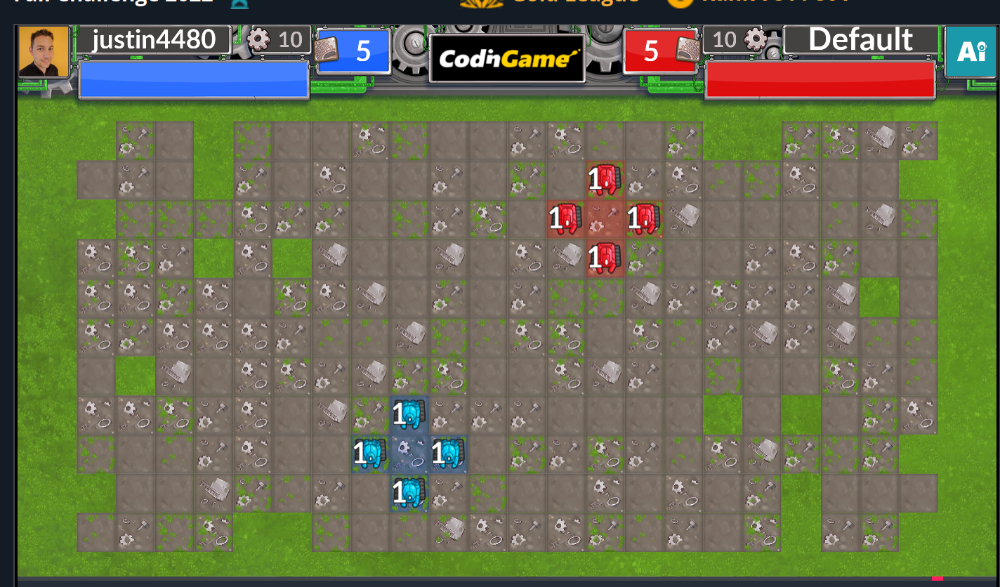

boundaries


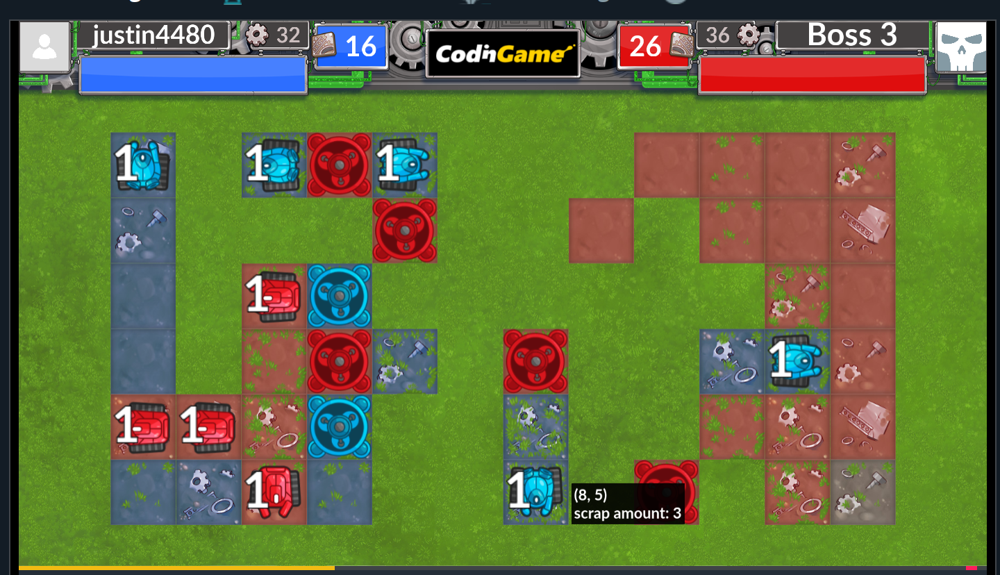

defensive_breach


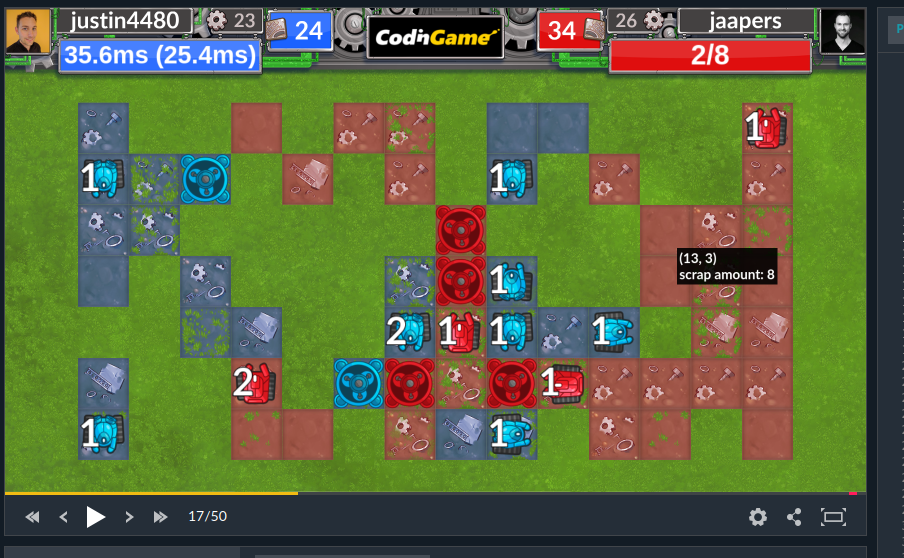

issue4


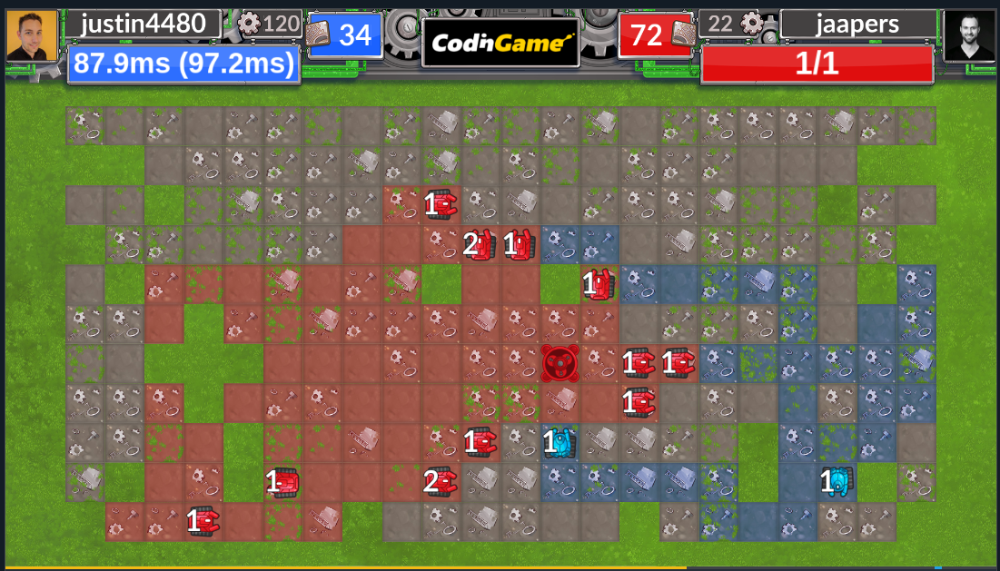

offensive_spawn_1_island


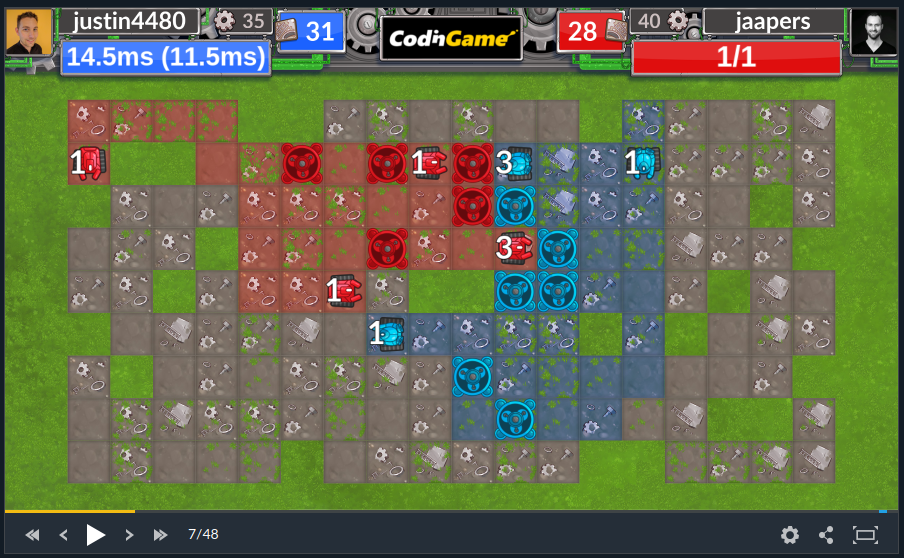

p272_crash


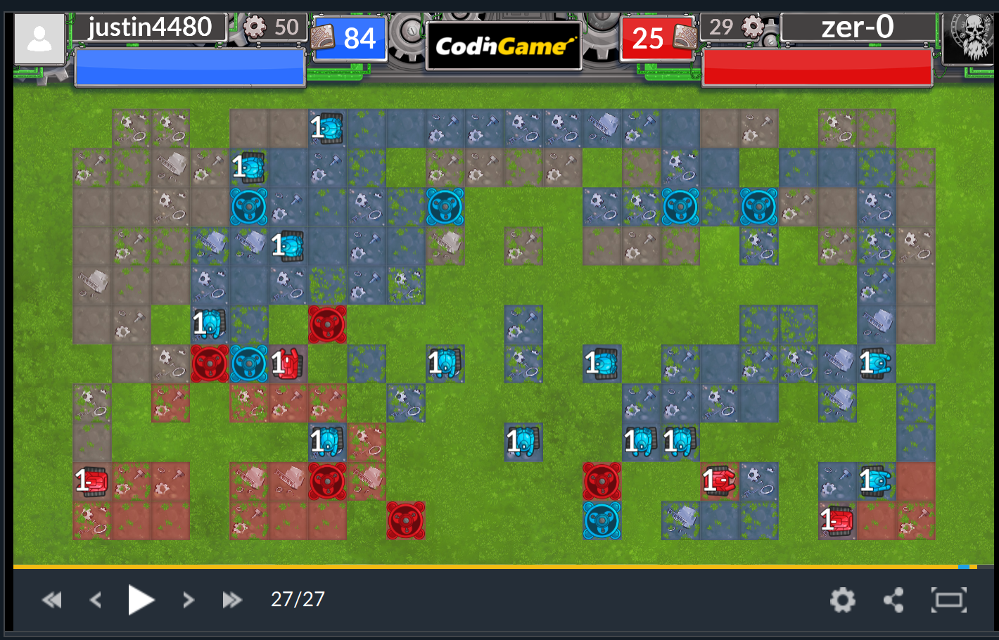

spawn_spread


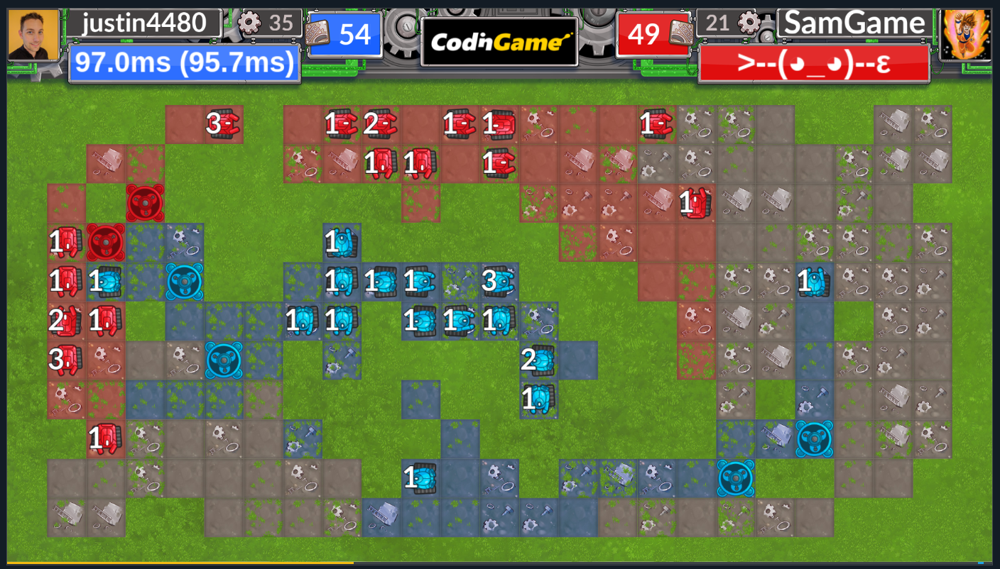

standard_start


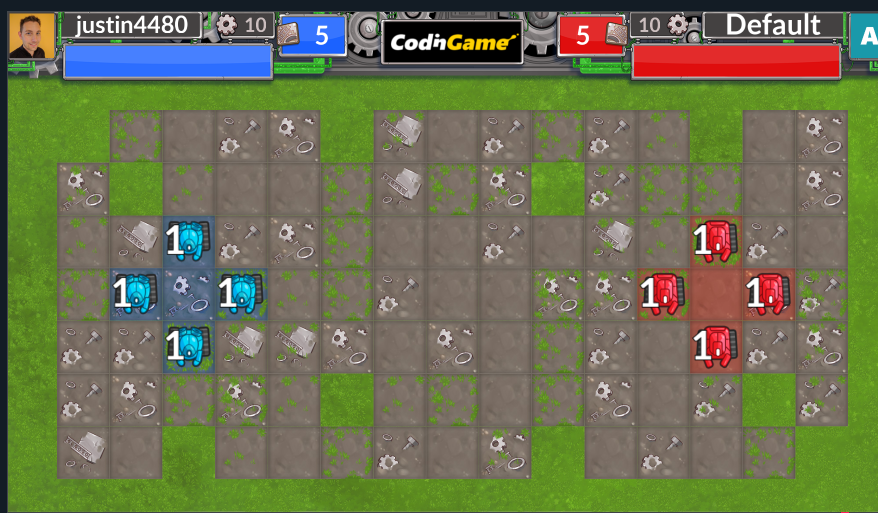

start_f5


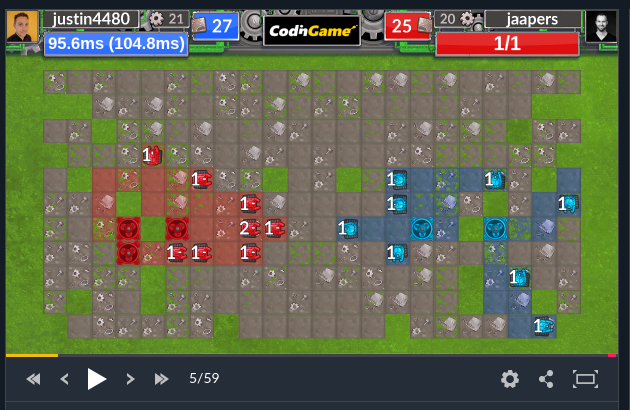

start_f9


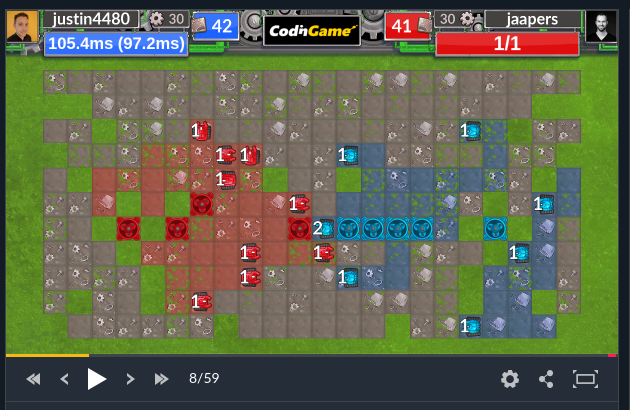

tight_path


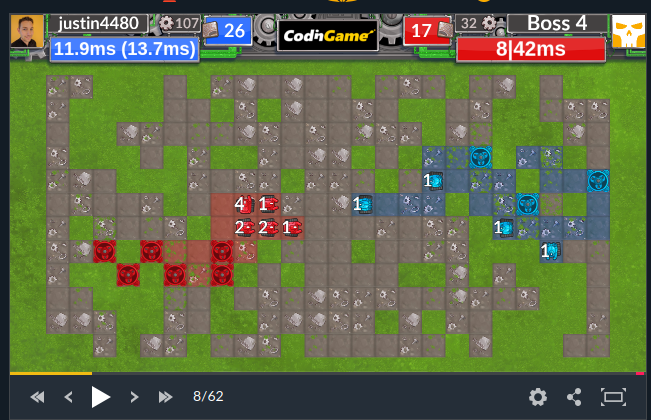

In [6]:
maps = ['big_start', 'boundaries', 'defensive_breach',
        'issue4', 'offensive_spawn_1_island', 'p272_crash', 'spawn_spread',
        'standard_start', 'start_f5', 'start_f9', 'tight_path']

for map in maps:
    print(map)
    with open(f'input_logs/{map}.txt', 'r') as f:
        col, row = f.readline().split()
    display(print_png(f'input_logs/{map}.png', int(20), int(10), scale=20))

# Convolution Kernels

Text(0.5, 1.0, 'Manhattan')

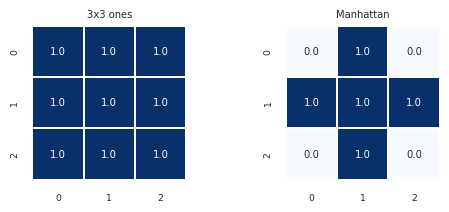

In [7]:
input = Input(log_file='start_f5.txt')
kernel = input.board(1).kernel_global
params = {'square': True, 'annot': True, 'fmt': '.1f', 'cbar': False,
          'vmin': 0, 'vmax': 1, 'linewidths': 0.1}
fig, ax = plt.subplots(1, 2, figsize=(6, 2))
sns.heatmap(input.board(1).kernel_3_3_ones, **params, cmap='Blues', ax=ax[0]).set_title('3x3 ones')
sns.heatmap(input.board(1).kernel_manhattan, **params, cmap='Blues', ax=ax[1]).set_title('Manhattan')

Text(0.5, 1.0, 'zoomed')

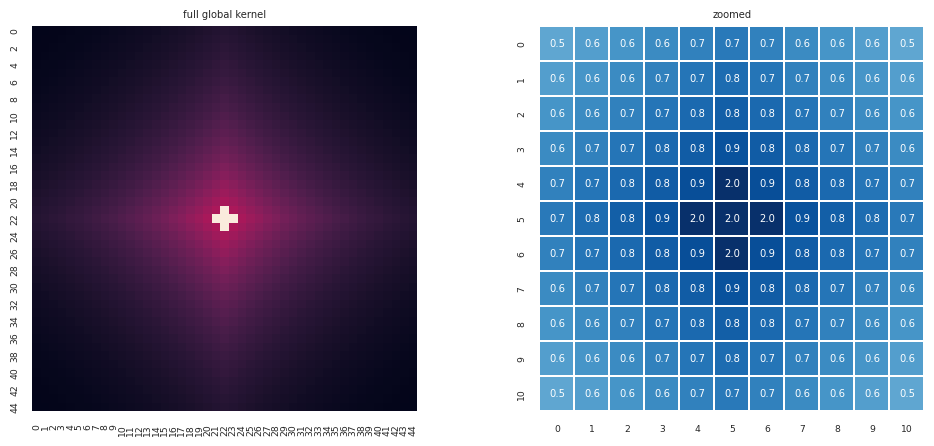

In [8]:
input = Input(log_file='start_f5.txt')
kernel = input.board(1).kernel_global
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
sns.heatmap(kernel, square=True, annot=False, cbar=False, ax=ax[0]).set_title('full global kernel')
sns.heatmap(kernel[17:28, 17:28], **params, cmap='Blues', ax=ax[1]).set_title('zoomed')

### Example map gradients (using local manhattan kernel)

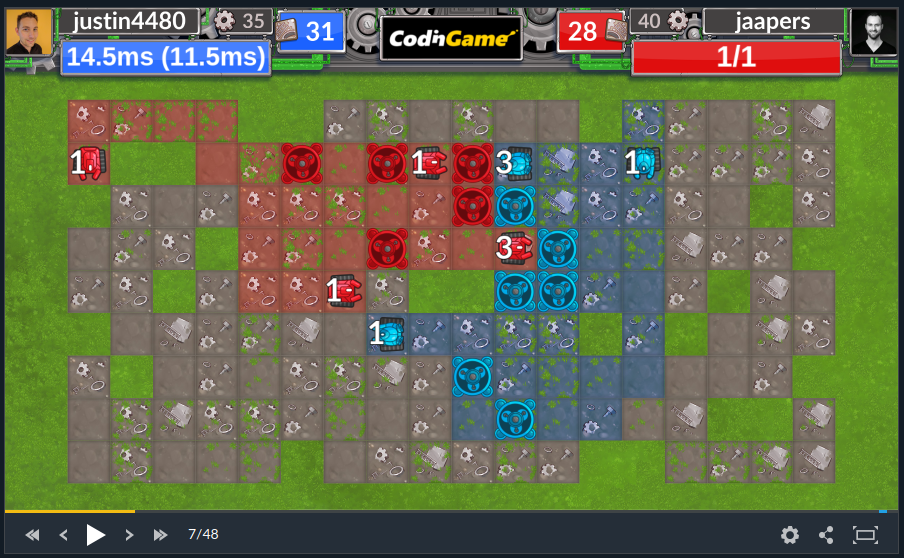

Text(0.5, 1.0, 'scrap_amount conv (manhattan kernel)')

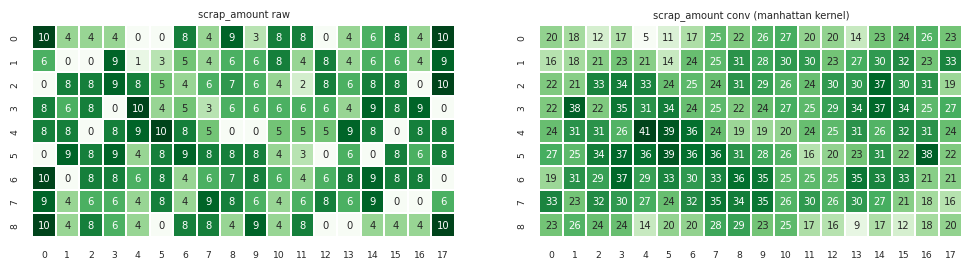

In [11]:
map = maps[4]
input = Input(log_file=f'{map}.txt')
display(print_png(f'input_logs/{map}.png', int(20), int(10), scale=30))
params = {'square': True, 'annot': True, 'fmt': 'd', 'cbar': False,
          'linewidths': 0.1, 'cmap': 'Greens'}
fig, ax = plt.subplots(1, 2, figsize=(12, 3))
sns.heatmap(input.board(1).scrap_amount.astype(int), **params, ax=ax[0]).set_title('scrap_amount raw')
sns.heatmap(input.board(1).scrap_amount_local.astype(int), **params, ax=ax[1]).set_title('scrap_amount conv (manhattan kernel)')

### Example map gradients (using global kernel)

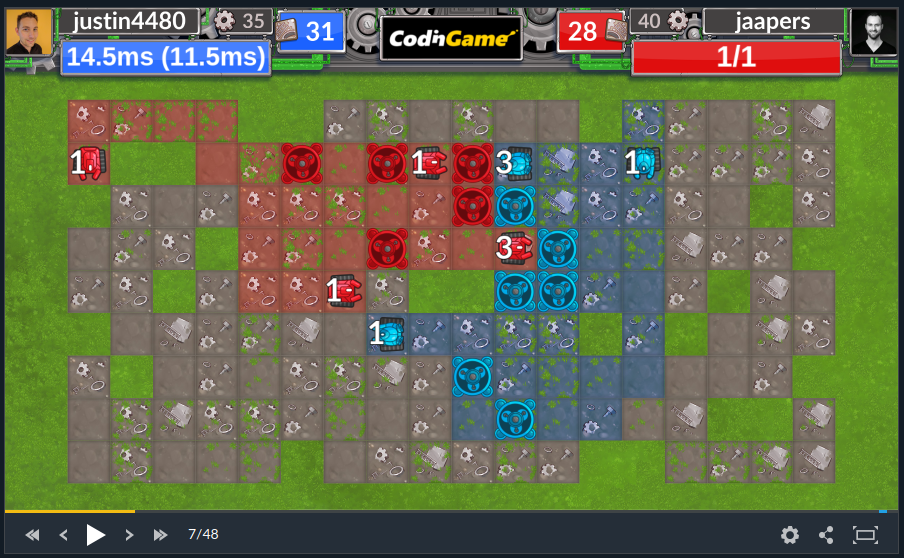

Text(0.5, 1.0, 'owner_op_global')

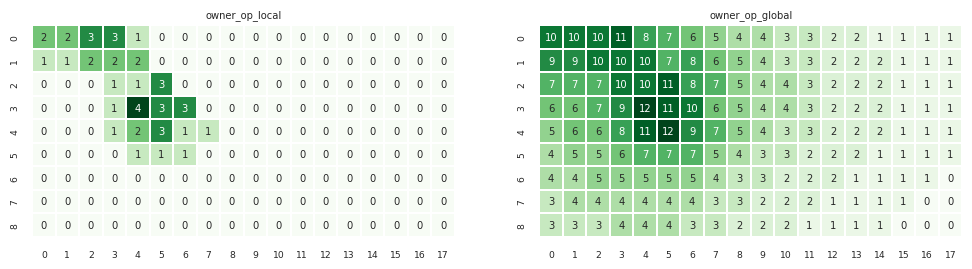

In [116]:
map = maps[4]
input = Input(log_file=f'{map}.txt')
display(print_png(f'input_logs/{map}.png', int(20), int(10), scale=30))
params = {'square': True, 'annot': True, 'fmt': 'd', 'cbar': False,
          'linewidths': 0.1, 'cmap': 'Greens'}
fig, ax = plt.subplots(1, 2, figsize=(12, 3))
sns.heatmap(input.board(1).owner_op_local.astype(int), **params, ax=ax[0]).set_title('owner_op_local')
sns.heatmap(input.board(1).owner_op_global.astype(int), **params, ax=ax[1]).set_title('owner_op_global')

### Map gradients layered

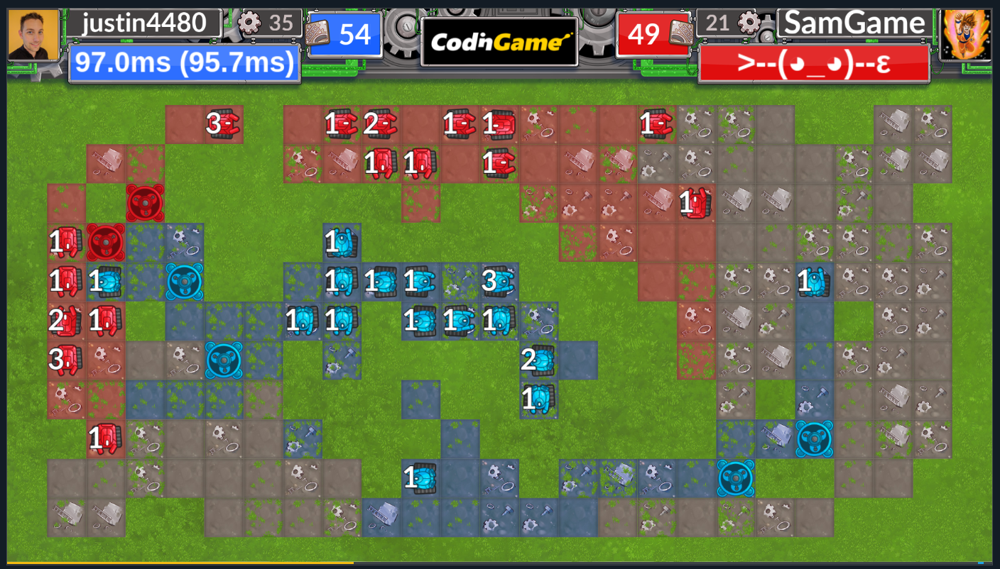

MOVE gradients


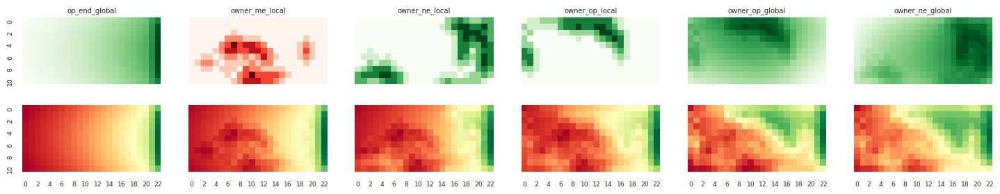

SPAWN gradients


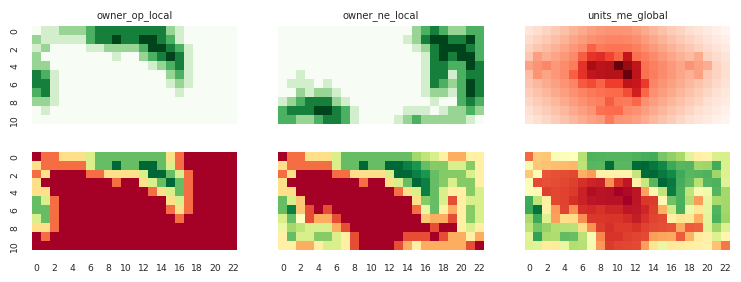

BUILD gradients


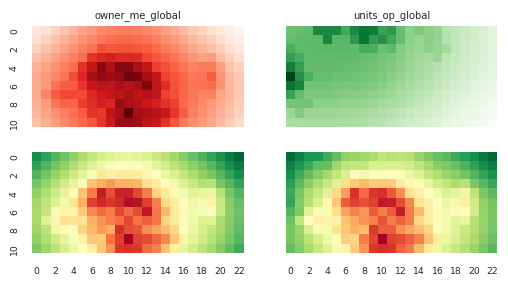

In [13]:
def show_heatmap(weights, board):
    min_max = lambda x: (x - x.min()) / (x.max() - x.min() + 1e-10)
    a = np.full_like(board.scrap_amount, 0, dtype=np.float64)

    fig, ax = plt.subplots(2, len(weights), figsize=(len(weights)*3, 3), sharex=True, sharey=True)
    for i, (key, value) in enumerate(weights.items()):
        b = min_max(getattr(board, key))
        a += b * value
        sns.heatmap(data=b, ax=ax[0, i], square=True, cbar=False, vmin=0, cmap='Greens' if value > 0 else 'Reds').set_title(key)
        sns.heatmap(data=a, ax=ax[1, i], square=True, cbar=False, cmap='RdYlGn')
    plt.show()

map = 'spawn_spread'
input = Input(log_file=f'{map}.txt')
display(print_png(f'input_logs/{map}.png', 12, 6, scale=30))

print('MOVE gradients')
show_heatmap({
        'op_end_global':    +5,
        'owner_me_local':   -1,
        'owner_ne_local':   +1,
        'owner_op_local':   +1,
        'owner_op_global':  +3,
        'owner_ne_global':  +2,
}, input.board(1))

print('SPAWN gradients')
show_heatmap({
        # 'op_end_global':    +5,
        'owner_op_local':   +4,
        'owner_ne_local':   +3,
        'units_me_global':  -1,
}, input.board(1))

print('BUILD gradients')
show_heatmap({
        'owner_me_global':  -5,
        'units_op_global':  +1,
}, input.board(1))

## Islands

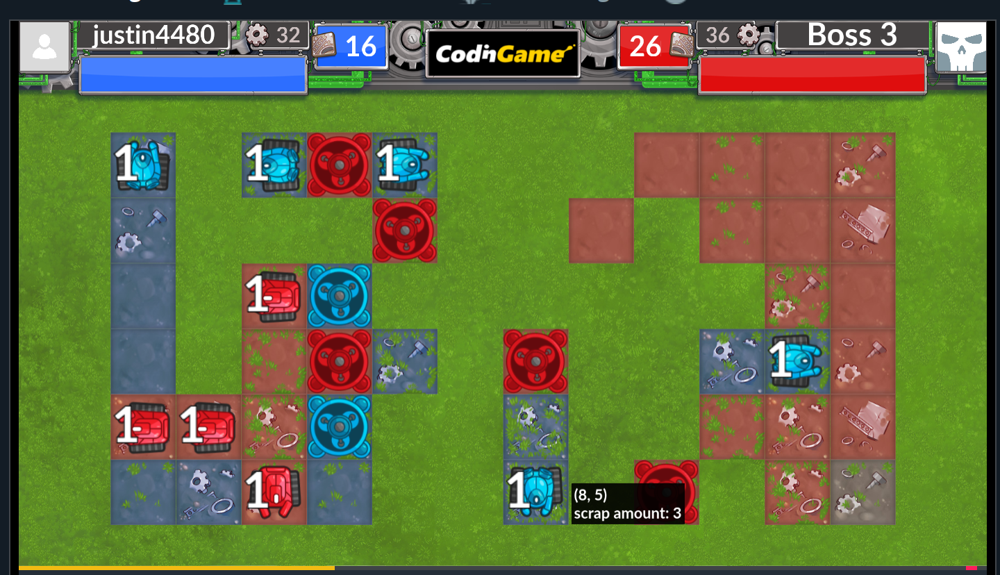

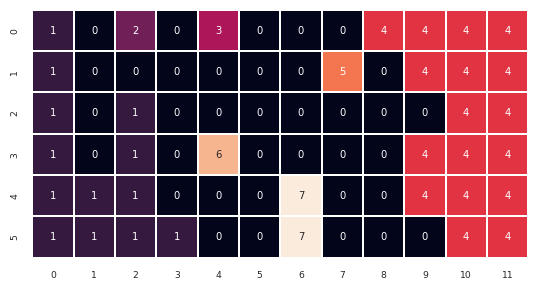

In [151]:
from scipy.ndimage import label

input = Input(log_file='boundaries.txt')
frame, my_matter, op_matter, input_array, board = input.all(1)

island = label(
    input=board.tile_live.astype(int),
    structure=[[0,1,0],
               [1,1,1],
               [0,1,0]],
)[0]

sns.heatmap(island, square=True, cbar=False, linecolor='white', linewidths=.1, annot=True, fmt='d')
print_png('input_logs/boundaries.png', 12, 6, scale=50)

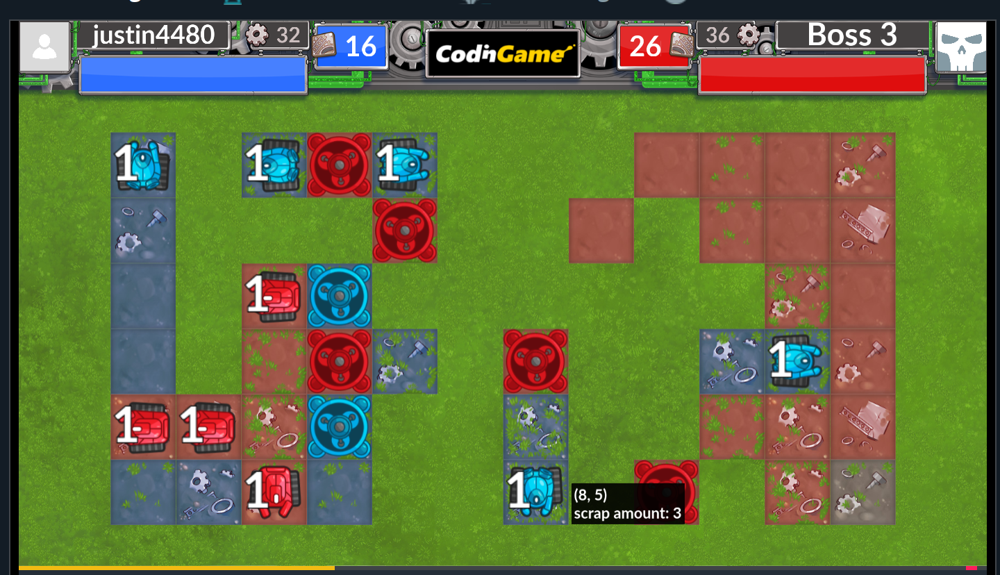

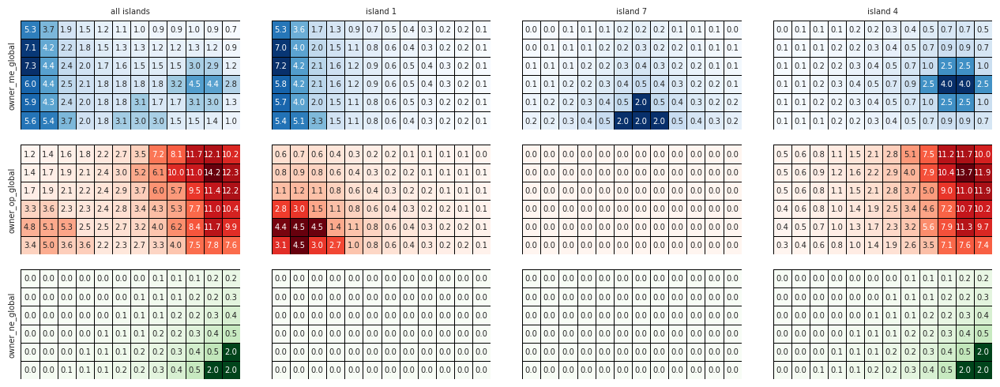

In [156]:
display(print_png(f'input_logs/boundaries.png', 10, 6, scale=45))

input = Input(log_file='boundaries.txt')

min_max = lambda x: (x - x.min()) / (x.max() - x.min())

default_params1 = {'linecolor': 'black', 'linewidths': .5, 'square': True, 'cbar': False, 'annot': True, 'fmt': ".1f"}
default_params2 = {'linecolor': 'black', 'linewidths': .5, 'square': True, 'cbar': False, 'annot': True, 'fmt': "d"}
frame, my_matter, op_matter, input_array, board = input.all(1)
fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(13, 5), sharex=True, sharey=True)
plt.tight_layout(h_pad=1, pad=1)

a = np.full_like(board.scrap_amount, 0, dtype=np.float64)

normalise = {
    'owner_op_global':    +20 * min_max(board.owner_op_global),
    'owner_me_global':    -10 * min_max(board.owner_me_global),
    'owner_ne_global':    +10 * min_max(board.owner_ne_global),
    'units_op_global':    +15 * min_max(board.units_op_global),
    'units_me_global':    -15 * min_max(board.units_me_global),
}

i = -1

i += 1
a += normalise['owner_me_global']
board.reset_island_number()
sns.heatmap(**default_params1, ax=ax[i, 0], data=board.owner_me_global, cmap='Blues').set_title('all islands')
board.set_island_number(1)
sns.heatmap(**default_params1, ax=ax[i, 1], data=board.owner_me_global, cmap='Blues').set_title('island 1')
board.set_island_number(7)
sns.heatmap(**default_params1, ax=ax[i, 2], data=board.owner_me_global, cmap='Blues').set_title('island 7')
board.set_island_number(4)
sns.heatmap(**default_params1, ax=ax[i, 3], data=board.owner_me_global, cmap='Blues').set_title('island 4')
ax[i, 0].set_ylabel('owner_me_global')

i += 1
a += normalise['owner_op_global']
board.reset_island_number()
sns.heatmap(**default_params1, ax=ax[i, 0], data=board.owner_op_global, cmap='Reds')
board.set_island_number(1)
sns.heatmap(**default_params1, ax=ax[i, 1], data=board.owner_op_global, cmap='Reds')
board.set_island_number(7)
sns.heatmap(**default_params1, ax=ax[i, 2], data=board.owner_op_global, cmap='Reds')
board.set_island_number(4)
sns.heatmap(**default_params1, ax=ax[i, 3], data=board.owner_op_global, cmap='Reds')
ax[i, 0].set_ylabel('owner_op_global')

i += 1
a += normalise['owner_ne_global']
board.reset_island_number()
sns.heatmap(**default_params1, ax=ax[i, 0], data=board.owner_ne_global, cmap='Greens')
board.set_island_number(1)
sns.heatmap(**default_params1, ax=ax[i, 1], data=board.owner_ne_global, cmap='Greens')
board.set_island_number(7)
sns.heatmap(**default_params1, ax=ax[i, 2], data=board.owner_ne_global, cmap='Greens')
board.set_island_number(4)
sns.heatmap(**default_params1, ax=ax[i, 3], data=board.owner_ne_global, cmap='Greens')
ax[i, 0].set_ylabel('owner_ne_global')

for ax in ax.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

# Zone breach via Linear Regression

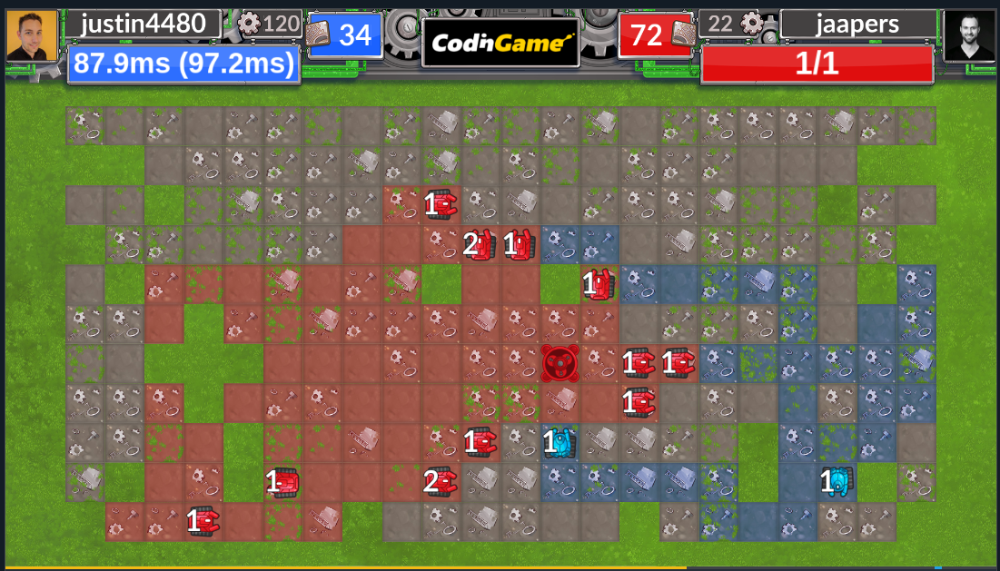

Text(0.5, 1.0, 'Zones')

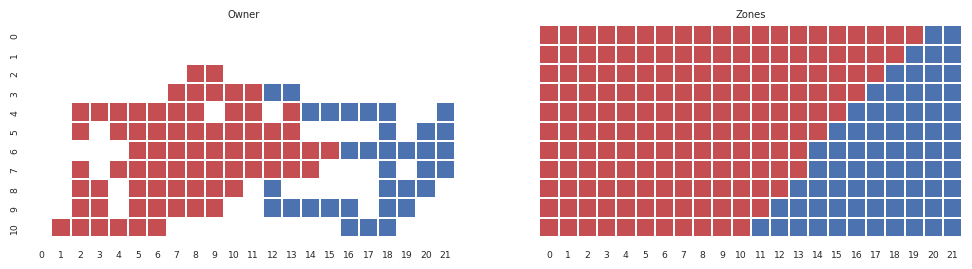

In [27]:
import pandas as pd
from sklearn.linear_model import LogisticRegression

scenario = maps[3]
input = Input(log_file=f'{scenario}.txt')
frame, my_matter, op_matter, input_array, board = input.all(1)

display(print_png(f'input_logs/{scenario}.png', 10, 6, scale=45))

df = pd.DataFrame(
    data=[(row, col, board.owner_me[row, col])
            for row in range(board.owner_me.shape[0])
            for col in range(board.owner_me.shape[1])],
    columns=['row', 'col', 'owner_me'])

lr = LogisticRegression(class_weight='balanced')
lr.fit(X=df[['row', 'col']], y=df.owner_me) 
zones = lr.predict(df[['row', 'col']]).reshape(board.owner_me.shape)

fig, ax = plt.subplots(1, 2, sharey=True, figsize=(12, 5))
sns.heatmap(board.owner, square=True, cbar=False, annot=False, linewidths=0.1, cmap=['white', 'white', 'b', 'r'], ax=ax[0]).set_title('Owner')
sns.heatmap(zones, square=True, cbar=False, linewidths=0.1, cmap=['r', 'b'], ax=ax[1]).set_title('Zones')

## Choke points

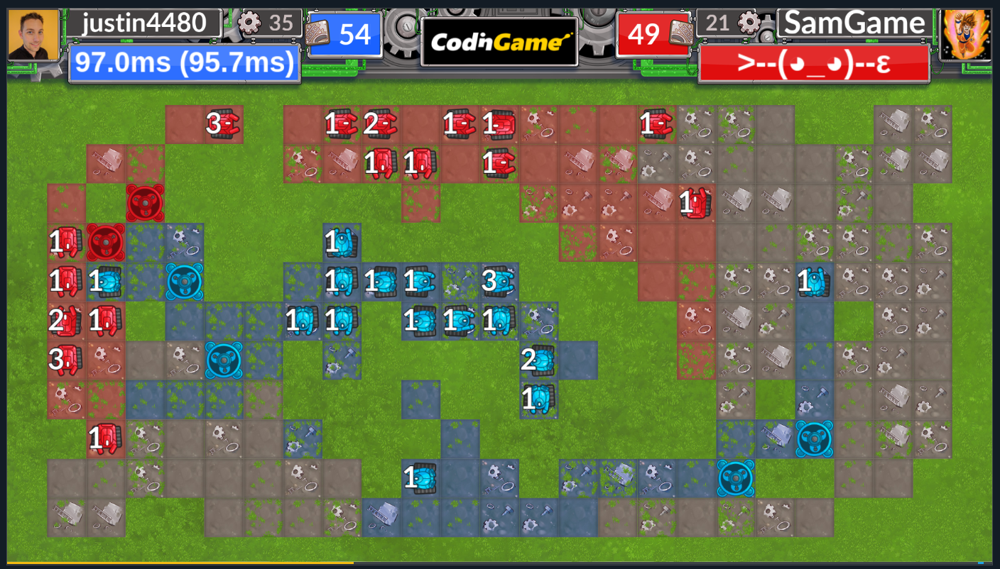

Text(0.5, 1.0, 'BUILD Target')

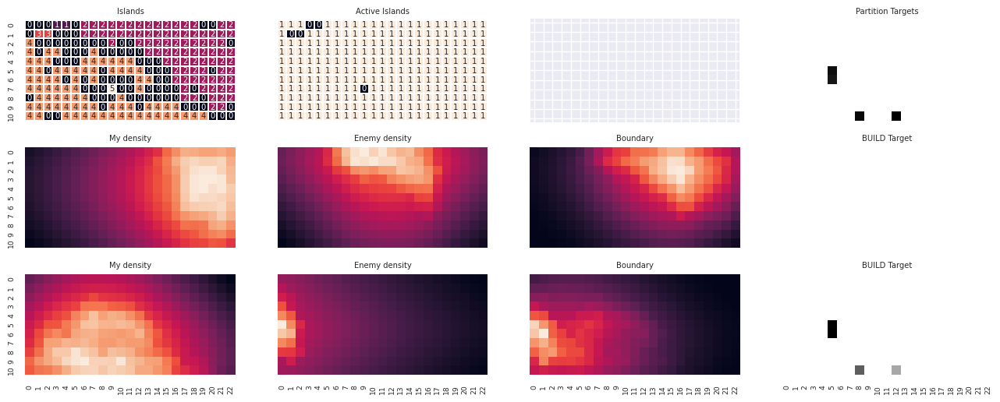

In [128]:
from scipy.signal import convolve2d

scenario = ['spawn_spread', 'boundaries', 'p272_crash'][0]
params = {'square': True, 'cbar': False}

input = Input(log_file=f'{scenario}.txt')
frame, my_matter, op_matter, input_array, board = input.all(1)

board.reset_island_number()
plt.show()
display(print_png(f'input_logs/{scenario}.png', 10, 6, scale=45))

min_max = lambda x: (x - x.min()) / (x.max() - x.min() + 1e-10)

c1 = convolve2d(board.tile_live, np.array([[0,1,0],[1,0,1],[0,1,0]]), mode='same') * board.tile_live
we = convolve2d(c1, np.array([[1/3, 1/2, 1/3]]), mode='same') == 3
ns = convolve2d(c1, np.array([[1/3],[1/2],[1/3]]), mode='same') == 3
d1 = convolve2d(c1+1, np.array([[1,0,0],[0,1/4,0],[0,0,1]]), mode='same') == 3
d2 = convolve2d(c1+1, np.array([[0,0,1],[0,1/4,0],[1,0,0]]), mode='same') == 3

build_targets = (
    convolve2d(
        (((board.units_me + board.owner_me) * (board.units_op == 0)) > 0),
        board.kernel_global,
        mode='same',
    ) * (we | ns | d1 | d2) * board.can_build
)

fig, ax = plt.subplots(3, 4, figsize=(16, 6), sharey=True, sharex=True)
sns.heatmap(board.island, **params, annot=True, linewidths=0.1, ax=ax[0, 0]).set_title('Islands')
sns.heatmap(np.isin(board.island, list(board.island_shared)), **params, annot=True, linewidths=0.1, ax=ax[0, 1]).set_title('Active Islands')
sns.heatmap(build_targets, **params, cmap='Greys', ax=ax[0, 3]).set_title('Partition Targets')

board.set_island_number(2)
if True:
    my_density = min_max(board.owner_me_global + board.owner_ne_global)
    enemy_density = min_max(board.units_op_global + board.owner_op_global)
    boundary = my_density * enemy_density
    best_build = build_targets * boundary * board.tile_live
sns.heatmap(my_density, **params, ax=ax[1, 0]).set_title('My density')
sns.heatmap(enemy_density, **params, ax=ax[1, 1]).set_title('Enemy density')
sns.heatmap(boundary, **params, ax=ax[1, 2]).set_title('Boundary')
sns.heatmap(best_build, **params, cmap='Greys', ax=ax[1, 3]).set_title('BUILD Target')

board.set_island_number(4)
if True:
    my_density = min_max(board.owner_me_global + board.owner_ne_global)
    enemy_density = min_max(board.units_op_global + board.owner_op_global)
    boundary = my_density * enemy_density
    best_build = build_targets * boundary * board.tile_live
sns.heatmap(my_density, **params, ax=ax[2, 0]).set_title('My density')
sns.heatmap(enemy_density, **params, ax=ax[2, 1]).set_title('Enemy density')
sns.heatmap(boundary, **params, ax=ax[2, 2]).set_title('Boundary')
sns.heatmap(best_build, **params, cmap='Greys', ax=ax[2, 3]).set_title('BUILD Target')